# eHMC: Proof of Concept

Proof of concept for combining emcee and HMC with several test functions.

## Environment

Let's initialize the environment.

In [1]:
import time, sys, os
from pandas.tools.plotting import autocorrelation_plot # autocorrelation plot
import corner
import fit_utils as fit

%pylab
%matplotlib inline

# re-defining plotting defaults
from matplotlib.font_manager import FontProperties
from matplotlib import gridspec
rcParams.update({'xtick.major.pad': '7.0'})
rcParams.update({'xtick.major.size': '7.5'})
rcParams.update({'xtick.major.width': '1.5'})
rcParams.update({'xtick.minor.pad': '7.0'})
rcParams.update({'xtick.minor.size': '3.5'})
rcParams.update({'xtick.minor.width': '1.0'})
rcParams.update({'ytick.major.pad': '7.0'})
rcParams.update({'ytick.major.size': '7.5'})
rcParams.update({'ytick.major.width': '1.5'})
rcParams.update({'ytick.minor.pad': '7.0'})
rcParams.update({'ytick.minor.size': '3.5'})
rcParams.update({'ytick.minor.width': '1.0'})
rcParams.update({'xtick.color': 'k'})
rcParams.update({'ytick.color': 'k'})
rcParams.update({'font.size': 30})

Using matplotlib backend: Qt5Agg
Populating the interactive namespace from numpy and matplotlib


## Basic Function: Correlated Bivariate Normal

In [2]:
C = array([[1., 0.95], [0.95, 1.]])
Cinv = inv(C)
Ntheta = 2

def lnp_bnorm(x):
    return -0.5*dot(x.T, dot(Cinv, x))

## Markov Chain Monte Carlo

We can sample from the posterior using **Markov Chain Monte Carlo** (MCMC). We evolve an individual chain in an MCMC sampler in three steps:
1. Based on the chain's current position $\mathbf{X}^{(t)}$ at iteration $t$, propose a new position $\mathbf{X}^{(t+1)}$ drawn from a **proposal distribution** (i.e. neighborhood function) $\mathbf{X}^{(t+1)} \sim g(\mathbf{X}^{(t+1)} = \mathbf{x}^{(t+1)} \,|\, \mathbf{X}^{(t)})$.
2. Compute the posterior $P(\mathbf{X}^{(t+1)} \,|\, \mathbf{D})$ given our data $\mathbf{D}$ at the proposed position $\mathbf{X}^{(t+1)}$.
3. Accept the proposed state with probability based on the **Metropolis criterion** via $A(\mathbf{X}^{(t+1)} \,|\, \mathbf{X}^{(t)}) = \min \left\lbrace 1, \frac{g(\mathbf{X}^{(t)} \,|\, \mathbf{X}^{(t+1)})}{g(\mathbf{X}^{(t+1)} \,|\, \mathbf{X}^{(t)})} \frac{P(\mathbf{X}^{(t+1)} \,|\, \mathbf{D})}{P(\mathbf{X}^{(t)} \,|\, \mathbf{D})} \right\rbrace$.

## Method 1: Metropolis-Hastings

Typically, a sampler will run $n$ chains where the proposal distribution for each chain $i$ at iteration $t$ is **additive** and centered on $\mathbf{X}_i^{(t)}$ such that 

$$ 
\mathbf{X}_i^{(t+1)} = \mathbf{X}_i^{(t)} + \mathbf{Z}_i \quad , \quad 
\mathbf{Z}_i \sim g_i(\mathbf{Z}_i = \mathbf{z})
$$ 

where $\mathbf{Z}_i$ is a **random variable** drawn from our proposal $g_i(\mathbf{z})$. A common choice is a Multivariate Normal such that $g_i(\mathbf{z}) = \mathcal{N}(\mathbf{z} \,|\, \mathbf{0}, \mathbf{C}_i)$. The resulting proposal distribution for $g(\mathbf{X}^{(t+1)} \,|\, \mathbf{X}^{(t)})$ is then symmetric between $\mathbf{X}_i^{(t)}$ and $\mathbf{X}_i^{(t+1)}$ such that $A(\mathbf{X}_i^{(t+1)} \,|\, \mathbf{X}_i^{(t)}) = \min \left\lbrace 1, \frac{P(\mathbf{X}_i^{(t+1)} \,|\, \mathbf{D})}{P(\mathbf{X}_i^{(t)} \,|\, \mathbf{D})} \right\rbrace$. This simple proposal and update scheme is often referred to as the **Metropolis-Hastings** (MH) algorithm.

### Disgression: Compound Transitions

In addition to the simple picture defined above, it is also useful to view the above transition from $\mathbf{X}^{(t)} \rightarrow \mathbf{X}^{(t+1)}$ as a number of **compound transitions** from our original state $\mathbf{X}^{(t)}$ to our final state $\mathbf{X}^{(t+1)}$. For instance, in the above case, we can consider the compound transition from $\mathbf{X}^{(t)} \rightarrow \mathbf{X}^{(t)}$ (the identity transition) and then from $\mathbf{X}^{(t)} \rightarrow \mathbf{X}^{(t+1)}$ via $\mathbf{Z}$. 

In the case where $\mathbf{Z} \sim \mathcal{N}(\mathbf{z} \,|\, \mathbf{0}, \mathbf{C})$, we can go one step further by noting that the sum of a series of multivariate normal random variables is itself multivariate normal. This enables us to write our original transition in terms of a number of "mini" transitions indexed by $\epsilon$ such that

$$ \mathbf{Z} \equiv \sum_\epsilon \mathbf{Z}_\epsilon \sim \mathcal{N}(\mathbf{z} \,|\, \mathbf{0}, \mathbf{C} \equiv \sum_\epsilon \mathbf{C}_\epsilon) \quad . $$

The transition probability between three consecutive intermediate states in this process $\mathbf{X}^{(1)} \rightarrow \mathbf{X}^{(2)} \rightarrow \mathbf{X}^{(3)}$ is 

$$ P(\mathbf{X}^{(1)} \rightarrow \mathbf{X}^{(2)} \rightarrow \mathbf{X}^{(3)}) 
= P(\mathbf{X}^{(1)} \rightarrow \mathbf{X}^{(2)}) \, P(\mathbf{X}^{(2)} \rightarrow \mathbf{X}^{(3)}) 
= \frac{P(\mathbf{X}_i^{(2)})}{P(\mathbf{X}_i^{(1)})} \frac{P(\mathbf{X}_i^{(3)})}{P(\mathbf{X}_i^{(2)})} 
= \frac{P(\mathbf{X}_i^{(3)})}{P(\mathbf{X}_i^{(1)})} \quad .
$$

This result where the intermediate transitions effectively cancel each other out can be directly generalized to an arbitrary number of intermediate transitions between our initial state $\mathbf{X}^{(t)}$ and our final proposed state $\mathbf{X}^{(t+1)}$. In other words, transitioning directly from $\mathbf{X}^{(t)} \rightarrow \mathbf{X}^{(t+1)}$ using a single proposal is **fundamentally equivalent** (and indistinguishable) from the same transition computed after an arbitrary number of compound proposals. This intuition is crucial for understanding the sampler we utilize later in the notebook.

### Generating Samples

Just as a brief demonstration, we'll utilize an extremely simple sampler. We'll set our proposal to be a bivariate Normal with independent entries.

In [3]:
pos_init = array([0,0]) # initial position
lnp_init = lnp_bnorm(pos_init) # initial lnP
Niter = 100000 # number of iterations
prop_cov = array([[1., 0.], [0., 1.]]) # proposal covariance

In [4]:
# run MH sampler
pos_chain_mh, lnp_chain_mh = fit.mh_sampler(Niter, pos_init, lnp_init, prop_cov, lnp_bnorm)

0 1000 2000 3000 4000 5000 6000 7000 8000 9000 10000 11000 12000 13000 14000 15000 16000 17000 18000 19000 20000 21000 22000 23000 24000 25000 26000 27000 28000 29000 30000 31000 32000 33000 34000 35000 36000 37000 38000 39000 40000 41000 42000 43000 44000 45000 46000 47000 48000 49000 50000 51000 52000 53000 54000 55000 56000 57000 58000 59000 60000 61000 62000 63000 64000 65000 66000 67000 68000 69000 70000 71000 72000 73000 74000 75000 76000 77000 78000 79000 80000 81000 82000 83000 84000 85000 86000 87000 88000 89000 90000 91000 92000 93000 94000 95000 96000 97000 98000 99000 

### Convergence Diagnostics

To check when our chain has burned in, we can look at the traces of each parameter.

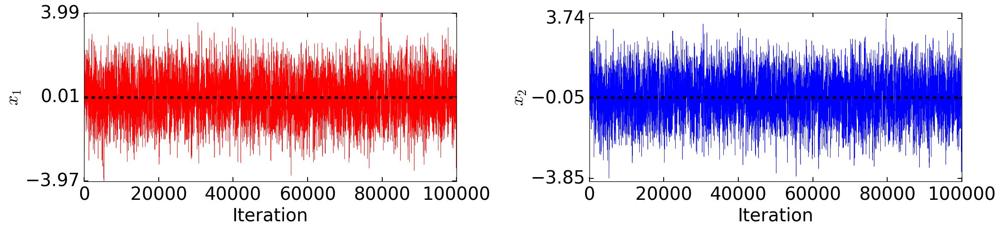

In [5]:
# plot trace
varcolors = ['red', 'blue'] # variable colors
varnames = ['$x_{'+str(i+1)+'}$' for i in xrange(2)]
thetas_true = [0, 0] # true results
figure(figsize=(24,6))
for i in xrange(2):
    subplot(1,2,i+1)
    samples = pos_chain_mh[:,i]
    plot(arange(Niter), samples, lw=0.5, color=varcolors[i], zorder=1)
    hlines(thetas_true[i], 0, Niter, colors='black', linestyles='dashed', lw=5, alpha=0.8, zorder=2)
    ymin, ymax = samples.min(), samples.max()
    yticks(linspace(ymin, ymax, 3).round(2))
    xlabel('Iteration')
    xlim([0, Niter])
    ylabel(varnames[i])
    tight_layout()

We can then check how efficiently we're sampling by examining our autocorrelation times.

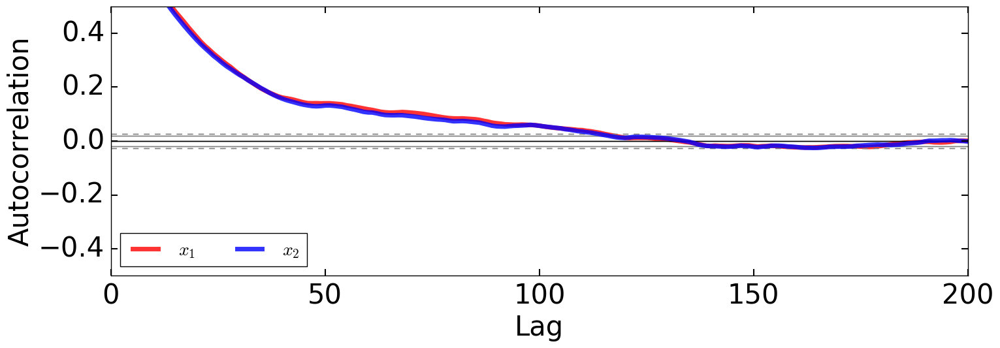

In [6]:
# plot autocorrelation lag
figure(figsize=(16,6))
h = [autocorrelation_plot(pos_chain_mh[50000:60000,i], color=varcolors[i], lw=5, alpha=0.8, label=varnames[i])
     for i in xrange(Ntheta)]
xlim([0, 200])
ylim([-0.5,0.5])
legend(loc='best', fontsize=20, ncol=Ntheta)
tight_layout()

Our sampler is quite inefficient, with ~50-100 samples needed before we propose an independent state.

Finally, a quick corner plot can confirm if we're sampling from the proper distribution or not.

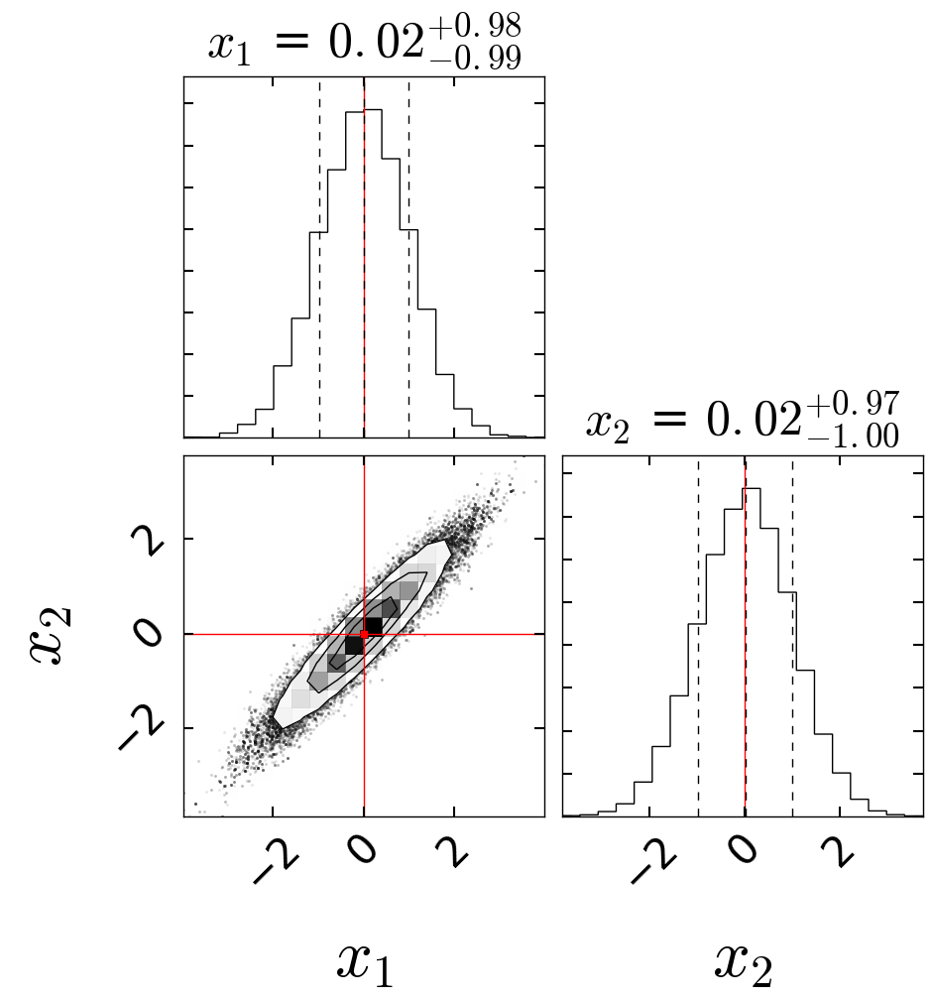

In [7]:
fig = corner.corner(pos_chain_mh, quantiles=[.16, .50, .84],
                    labels=varnames, label_kwargs={'fontsize':48}, 
                    truths=thetas_true, truth_color='red', 
                    show_titles=True, title_kwargs={'y':1.04},
                    fig=subplots(2,2,figsize=(10,10))[0])

## Method 2: `emcee`

One way to avoid having to tune your proposal distribution is using a **particle sampler** where a "swarm" of particles probes the distribution and proposals are determined from properties of the ensemble. One elegant (and popular) implementation is the **affine-invariant ensemble MCMC sampler** outlined in Goodman & Weare (2010) and popularized by Foreman-Mackey et al. (2013) as `emcee`.

### The Stretch Move

The proposal distribution for the affine-invariant ensemble sampler differs from that of the typical proposal discussed above in three ways:
1. The proposal for a **walker** (i.e. particle) $i$ at $\mathbf{X_i}$ is centered on the position of a randomly selected walker $j \neq i$ located at position $\mathbf{X}_j$.
2. The "breadth" of the proposal is based on the distance between the two walkers $\Delta \mathbf{X}_{ij} \equiv \mathbf{X}_i - \mathbf{X}_j$.
3. The proposal is **multiplicative** rather than additive.

This allows it to adapt to features in the space in a way that is robust to linear transformations.

More formally, emcee's affine-invariant update is a **stretch move** where the new position $\mathbf{X}_i(t+1)$ is proposed via

$$ \mathbf{X}_i^{(t+1)} = \mathbf{X}_j^{(t)} + Z \, \Delta \mathbf{X}_{ij}^{(t)} $$

where $\Delta \mathbf{X}_{ij} \equiv \mathbf{X}_i - \mathbf{X}_j$ is the vector spanning the two walkers and 

$$ Z \sim g(Z = z) \quad , \quad g(z) \equiv z^{-1/2} \: \textrm{for} \: z \in \left[a^{-1}, a \right] \: \textrm{and zero otherwise} $$

is a random variable drawn from our stretch proposal, where $a$ is most often set to 2. Another way to write this is as the compound transition $\mathbf{X}_i^{(t)} \rightarrow \mathbf{X}_j^{(t)} \rightarrow \mathbf{X}_i^{(t+1)}$, which better illustrates that our transition is fundamentally centered on $\mathbf{X}_j^{(t)}$ rather than $\mathbf{X}_i^{(t)}$.

It is important to note that the resulting proposal is *not* symmetric between $\mathbf{X}_i^{(t)}$ and $\mathbf{X}_i^{(t+1)}$ due to the differences in the relative vector span $\Delta \mathbf{X}_{ij}^{(t)}$ and $\Delta \mathbf{X}_{ij}^{(t+1)}$. The modified Metropolis update can, however, be shown to be

$$ A(\mathbf{X}_i^{(t+1)} \,|\, \mathbf{X}_i^{(t)}) = \min \left\lbrace 1, Z^{N-1} \frac{P(\mathbf{X}_i^{(t+1)} \,|\, \mathbf{D})}{P(\mathbf{X}_i^{(t)} \,|\, \mathbf{D})} \right\rbrace \quad . $$

Intuitively, we can understand the prefactor by noting that the particular functional form for $g(z)$ gives an update proportional to $z^{-1/2}$ that shows up in both parts of our proposal, giving us a constant prefactor of $Z^{-1}$. However, since $g(z^{-1}) = z g(z)$ and we've applied our stretch factor $Z$ in $N$ dimensions, we pick up a factor of $Z^{N}$. Functionally, this just means that we reward large stretch moves (which are more unlikely) and penalize small stretch moves (which are more likely).

### Generating Samples

Our implementation of `emcee` is mostly identical to the version discussed above except that we utilize **simulated annealing** to improve convergence to the posterior during burn-in.

In [8]:
Nwalkers = 256 # number of walkers
pos_init = multivariate_normal(zeros(Ntheta), prop_cov, size=Nwalkers) # initial positions
lnp_init = array([lnp_bnorm(p) for p in pos_init]) # initial lnPs
Nburn, Niter = 128, 512 # number of burn-in and sampling iterations
T_max = 25. # starting (maximum) temperature

In [9]:
emcee_sampler = fit.emcee_sampler(Niter, pos_init, lnp_init, lnp_bnorm, Nburn, T_max) # run emcee
pos_chain_emcee, lnp_chain_emcee, pos_burn_emcee, lnp_burn_emcee = emcee_sampler # re-assign outputs

10 20 30 40 50 60 70 80 90 100 110 120 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 

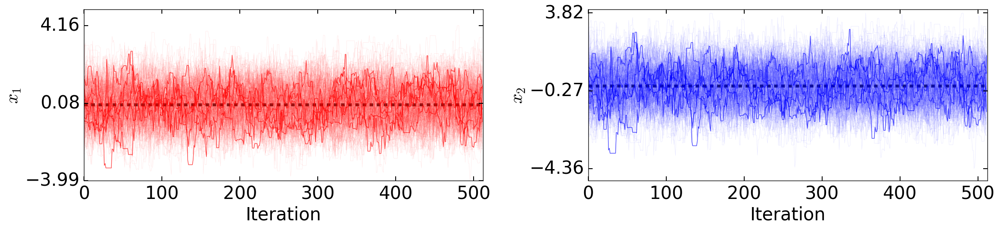

In [10]:
# plot trace
hwalkers = choice(Nwalkers, replace=False, size=5) # random selection of walkers to highlight to gauge behavior
figure(figsize=(24,6))
for i in xrange(2):
    subplot(1,2,i+1)
    samples = pos_chain_emcee[:,:,i] # grab samples
    plot(arange(Niter), samples, lw=0.5, alpha=0.1, color=varcolors[i]) # all walkers
    plot(arange(Niter), samples[:,hwalkers], lw=1, alpha=0.7, color=varcolors[i]) # highlighted
    hlines(thetas_true[i], 0, Niter, colors='black', linestyles='dashed', lw=5, alpha=0.8, zorder=2)
    ymin, ymax = samples.min(), samples.max()
    yticks(linspace(ymin, ymax, 3).round(2))
    xlabel('Iteration')
    xlim([0, Niter])
    ylabel(varnames[i])
    tight_layout()

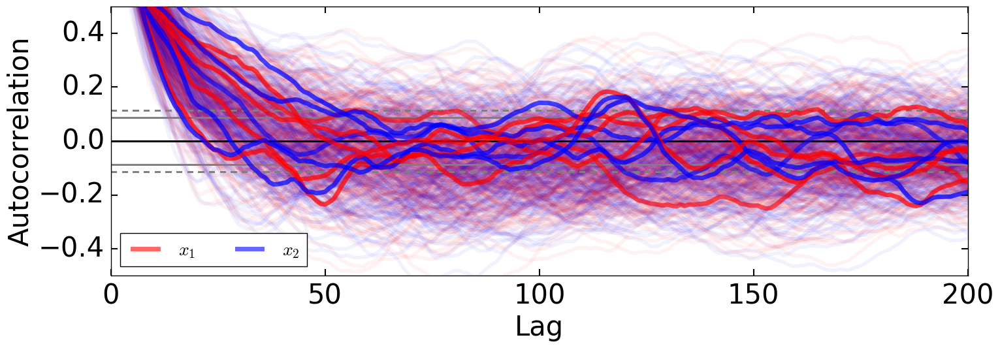

In [11]:
# plot autocorrelation lag
figure(figsize=(16,6))
h = [autocorrelation_plot(pos_chain_emcee[:,hwalkers[0],i], color=varcolors[i], lw=5, alpha=0.6, zorder=10, label=varnames[i])
     for i in xrange(Ntheta)]
h = [[autocorrelation_plot(pos_chain_emcee[:,j,i], color=varcolors[i], lw=5, alpha=0.7, zorder=10)
     for i in xrange(Ntheta)] 
    for j in hwalkers[1:]]
h = [[autocorrelation_plot(pos_chain_emcee[:,j,i], color=varcolors[i], lw=4, alpha=0.05, zorder=1)
     for i in xrange(Ntheta)] 
    for j in xrange(Nwalkers)]
xlim([0, 200])
ylim([-0.5, 0.5])
legend(loc='best', fontsize=20, ncol=Ntheta)
tight_layout()

Our samples are significantly less correlated here: only ~25-50 iterations are needed before we're drawing independent samples (a factor of 2 improvement).

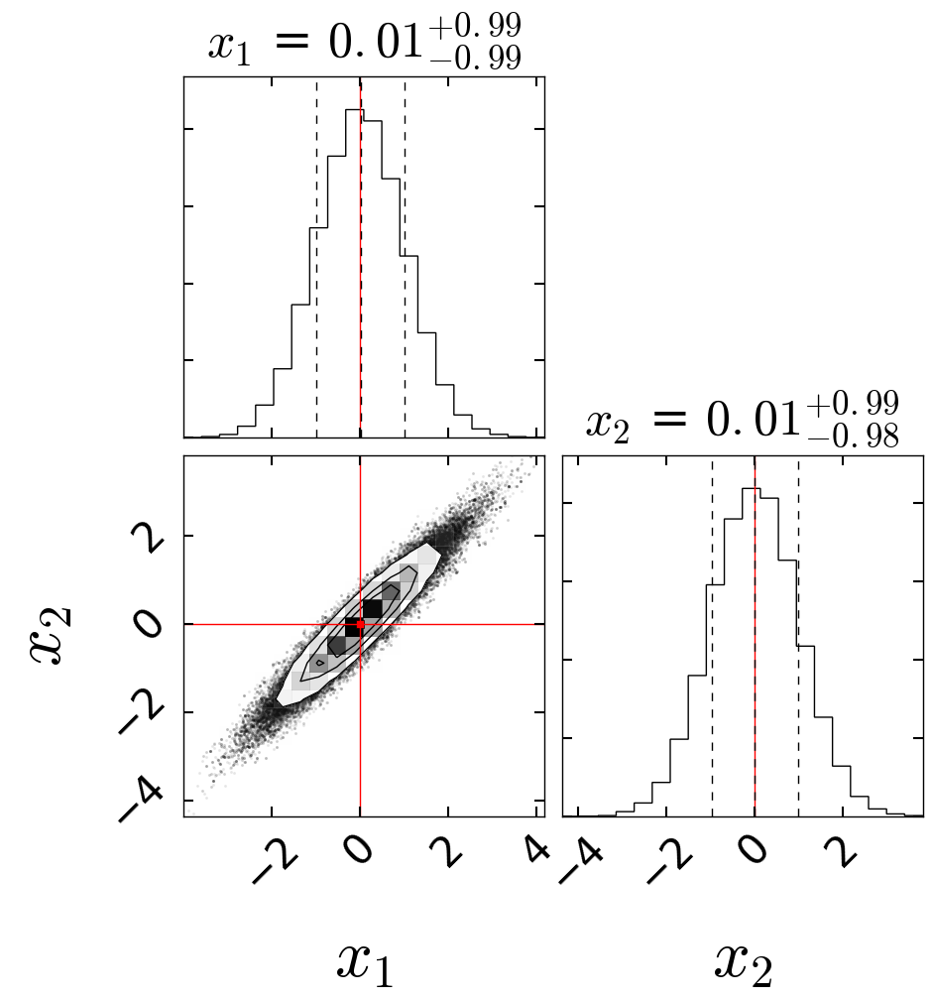

In [12]:
fig = corner.corner(pos_chain_emcee.reshape(-1,Ntheta), quantiles=[.16, .50, .84],
                    labels=varnames, label_kwargs={'fontsize':48}, 
                    truths=thetas_true, truth_color='red', 
                    show_titles=True, title_kwargs={'y':1.04},
                    fig=subplots(2,2,figsize=(10,10))[0])

## Method 3: Hamiltonian Monte Carlo

To cut down on the correlation times, we can utilize the **gradients** of our log-posterior to propose new positions using **Hamiltonian Monte Carlo (HMC)**.

### Hamiltonian Dynamics

In brief, we can sample from the distribution by simulating a particle "rolling" around the potential with position $\mathbf{q}$ and momentum $\mathbf{p}$ such that 

$$ P(\mathbf{q}, \mathbf{p}) = \frac{1}{Z} \exp\left[ -\frac{H(\mathbf{q}, \mathbf{p})}{T} \right] = \frac{1}{Z} \exp\left[ -\frac{U(\mathbf{q})}{T} \right] \exp\left[ -\frac{K(\mathbf{p})}{T} \right] $$

where the Hamiltonian $H(\mathbf{q},\mathbf{p}) = U(\mathbf{q}) + K(\mathbf{p})$ is just a sum over the potential energy $U(\mathbf{q})$ and kinetic energy $K(\mathbf{p})$ of the particle, $T$ is the temperature of the system, and $Z$ is a normalizing constant.

Letting:
- our position $\mathbf{q} \equiv \boldsymbol{\theta}$ be our parameters of interest, 
- our momentum $\mathbf{p} \equiv \mathbf{M} \boldsymbol{\dot{\theta}}$ be a set of **auxiliary variables** tracking the change in our parameters of interest multiplied by a **mass matrix** $\mathbf{M}$, 
- our potential energy $U(\mathbf{q}) = −\ln P(\mathbf{q} \,|\, \mathbf{\hat{F}}) $ be the negative log-posterior, 
- and our kinetic energy $K(p) = \frac{1}{2} \mathbf{p}^T \mathbf{M}^{-1} \mathbf{p}$ be in a standard quadratic form, 

we get

$$ P(\mathbf{q}, \mathbf{p}) \propto \exp\left[ -\frac{1}{2} \mathbf{p}^T \mathbf{M}^{-1} \mathbf{p} \right] \, P(\mathbf{q} \,|\, \mathbf{\hat{F}}) $$

where we have set $T=1$.

Since the Hamiltonian is conserved, the system evolves according to Hamilton's equations such that

$$ 
\frac{\partial \mathbf{q}}{\partial t} = \nabla_{\mathbf{p}} K = \mathbf{M}^{-1} \mathbf{p} \quad , \quad 
\frac{\partial \mathbf{p}}{\partial t} = - \nabla_{\mathbf{q}} U = \nabla_{\mathbf{q}} \ln P( \mathbf{q} \,|\, \mathbf{\hat{F}})
$$

where $U(\boldsymbol{\theta})$ is defined as above. 

### Evolving the System

We can numerically evolve our system for $L$ small timesteps $\epsilon$ using any stable numerical integrator. A common choice is the **leapfrog method**:

\begin{align}
\textrm{Initial momentum half step:}& \quad \mathbf{p}(t+\epsilon/2) = \mathbf{p}(t) + \epsilon/2 \times \nabla_{\mathbf{q}} \ln P( \mathbf{q}(t) \,|\, \mathbf{\hat{F}}) \\
\textrm{Position leapfrog:}& \quad \mathbf{q}(t+\epsilon) = \mathbf{q}(t) + \epsilon \times \mathbf{M}^{-1} \mathbf{p}(t+\epsilon/2) \\
\textrm{Momentum leapfrog:}& \quad \mathbf{p}(t+\epsilon+\epsilon/2) = \mathbf{p}(t+\epsilon/2) + \epsilon \times \nabla_{\mathbf{q}} \ln P( \mathbf{q}(t+\epsilon) \,|\, \mathbf{\hat{F}}) \\
\vdots \\
\textrm{Momentum leapfrog:}& \quad \mathbf{p}(t+(L-1)\epsilon+\epsilon/2) = \mathbf{p}(t+(L-2)\epsilon+\epsilon/2) + \epsilon \times \nabla_{\mathbf{q}} \ln P( \mathbf{q}(t+(L-1)\epsilon) \,|\, \mathbf{\hat{F}}) \\
\textrm{Position leapfrog:}& \quad \mathbf{q}(t+L\epsilon) = \mathbf{q}(t+(L-1)\epsilon) + \epsilon \times \mathbf{M}^{-1} \mathbf{p}(t+\epsilon/2)(t+(L-1)\epsilon+\epsilon/2) \\
\textrm{Final momentum half step:}& \quad \mathbf{p}(t+L\epsilon) = \mathbf{p}(t+(L-1)\epsilon+\epsilon/2) + \epsilon/2 \times \nabla_{\mathbf{q}} \ln P( \mathbf{q}(t+L\epsilon) \,|\, \mathbf{\hat{F}}) \\
\end{align}

### HMC Algorithm

First, we change the momentum (i.e. give the particle a "kick" in a random direction) by sampling from our energy distribution 

$$ \mathbf{p} \sim \exp\left[ -\frac{1}{2} \mathbf{p}^T \mathbf{M}^{-1} \mathbf{p} \right] \propto \mathcal{N}(\mathbf{p} \,|\, \mathbf{0}, \mathbf{M}) $$

which is proportional to a multivariate Normal with mean $\mathbf{0}$ and covariance $\mathbf{M}$.

Next, we propose a new state using Hamiltonian dynamics. Starting at $(\mathbf{q}, \mathbf{p})$, we evolve the system for $L$ steps of size $\epsilon$. The momentum variables are then negated (although this rarely needs to be done in practice), leaving us with the proposed state $(\mathbf{q}^*, \mathbf{p}^*)$.

Finally, we perform a **Metropolis update**, accepting the proposed state with probability

$$ \min \left\lbrace 1, \, \exp\left[-H(\mathbf{q}^*, \mathbf{p}^*) + H(\mathbf{q}, \mathbf{p}) \right] \right\rbrace = \min \left\lbrace 1, \, \exp\left[-U(\mathbf{q}^*) + U(\mathbf{q}) - K(\mathbf{p}^*) + K(\mathbf{p}) \right] \right\rbrace $$

### Generating Samples

Let's now define our gradients and generate some samples.

In [13]:
def lnp_bnorm_grad(x):
    return -dot(Cinv, x)

In [22]:
L, epsilon = 50, 0.15
pos_init = zeros(Ntheta)
mass = eye(Ntheta)
mass_inv = inv(mass)
Niter = 10000

In [23]:
pos_chain_hmc, lnp_chain_hmc = fit.hmc_sampler(pos_init, Niter, L, epsilon, mass, mass_inv, lnp_bnorm, lnp_bnorm_grad)

0 100 200 300 400 500 600 700 800 900 1000 1100 1200 1300 1400 1500 1600 1700 1800 1900 2000 2100 2200 2300 2400 2500 2600 2700 2800 2900 3000 3100 3200 3300 3400 3500 3600 3700 3800 3900 4000 4100 4200 4300 4400 4500 4600 4700 4800 4900 5000 5100 5200 5300 5400 5500 5600 5700 5800 5900 6000 6100 6200 6300 6400 6500 6600 6700 6800 6900 7000 7100 7200 7300 7400 7500 7600 7700 7800 7900 8000 8100 8200 8300 8400 8500 8600 8700 8800 8900 9000 9100 9200 9300 9400 9500 9600 9700 9800 9900 

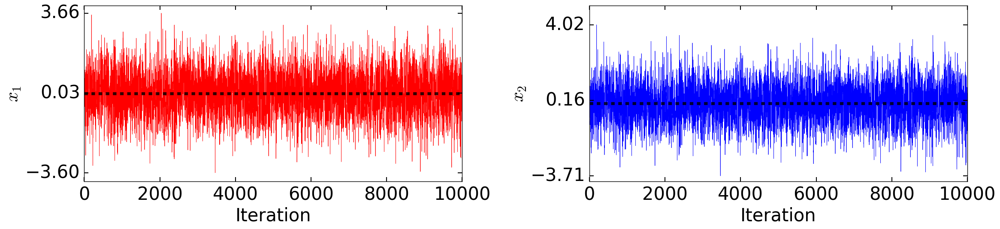

In [24]:
# plot trace
varcolors = ['red', 'blue'] # variable colors
varnames = ['$x_{'+str(i+1)+'}$' for i in xrange(2)]
thetas_true = [0, 0] # true results
figure(figsize=(24,6))
for i in xrange(2):
    subplot(1,2,i+1)
    samples = pos_chain_hmc[:,i]
    plot(arange(Niter), samples, lw=0.5, color=varcolors[i], zorder=1)
    hlines(thetas_true[i], 0, Niter, colors='black', linestyles='dashed', lw=5, alpha=0.8, zorder=2)
    ymin, ymax = samples.min(), samples.max()
    yticks(linspace(ymin, ymax, 3).round(2))
    xlabel('Iteration')
    xlim([0, Niter])
    ylabel(varnames[i])
    tight_layout()

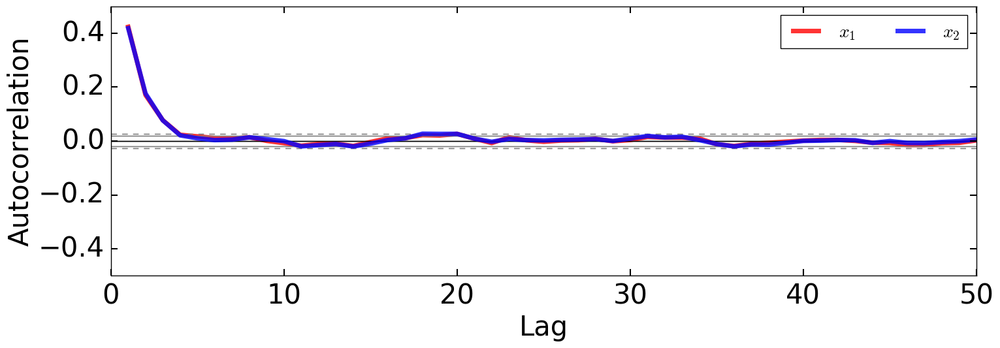

In [25]:
# plot autocorrelation lag
figure(figsize=(16,6))
h = [autocorrelation_plot(pos_chain_hmc[:,i], color=varcolors[i], lw=5, alpha=0.8, label=varnames[i])
     for i in xrange(Ntheta)]
xlim([0, 50])
ylim([-0.5,0.5])
legend(loc='best', fontsize=20, ncol=Ntheta)
tight_layout()

Compared with our previous results, our HMC sampler is extremely efficient at generating samples, with auto-correlation times on order ~5-10 samples (a factor of 5 better than `emcee`).

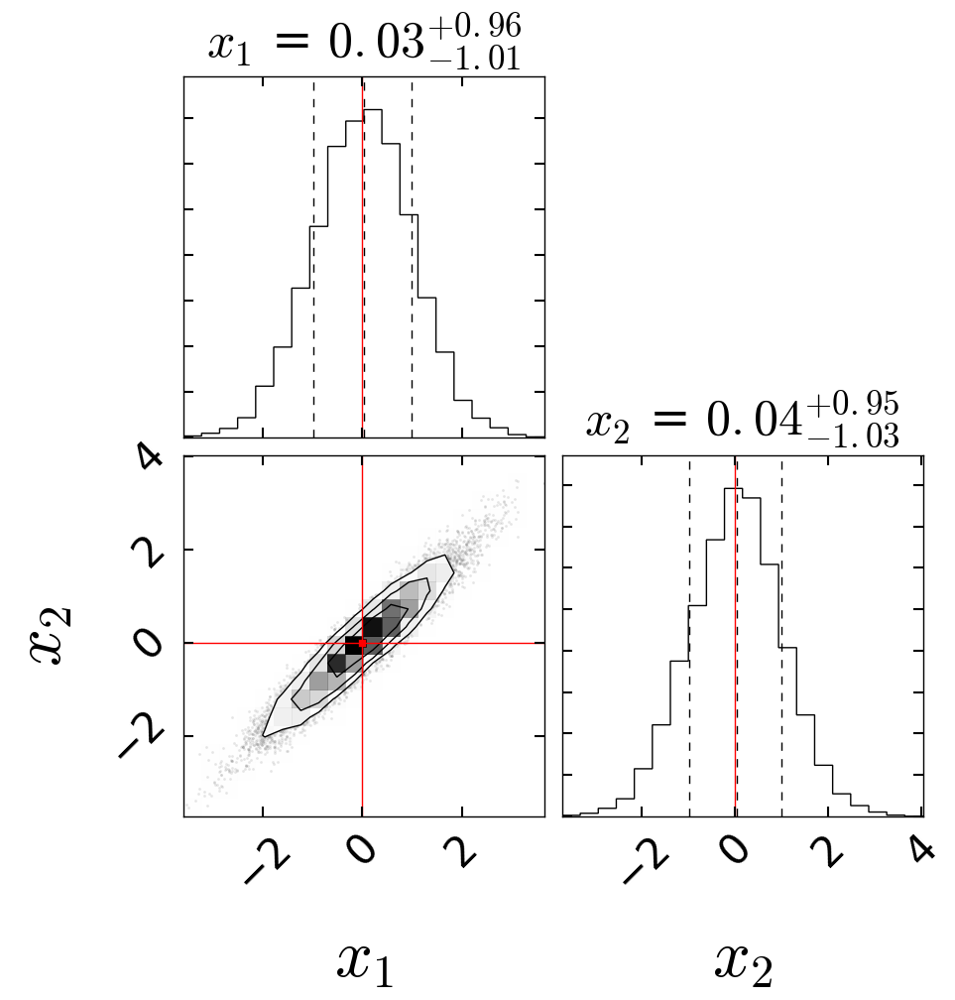

In [26]:
fig = corner.corner(pos_chain_hmc, quantiles=[.16, .50, .84],
                    labels=varnames, label_kwargs={'fontsize':48}, 
                    truths=thetas_true, truth_color='red', 
                    show_titles=True, title_kwargs={'y':1.04},
                    fig=subplots(2,2,figsize=(10,10))[0])

## Method 4: eHMC

While `emcee` works well at small/moderate dimensionality ($N<20$ or so) and can sample pretty much any arbitrary distribution, it struggles in high dimensions. Alternately, while HMC thrives in high dimensions (due to its high acceptance rate and efficient posterior exploration), it can only work for variables which have gradients. What about for distributions for which some variables are difficult to sample/do not have gradients while others are easy to sample/do have gradients?

We propose using a combination of `emcee` and HMC that we are tentatively calling "eh" MC (shrug definitely emphasized). For a walker $i$ located at position $\boldsymbol{\Theta}_i \equiv (\mathbf{X}_i, \mathbf{Y}_i)$ where $\mathbf{X}$ encompasses are our $N_X$ "hard" variables without easily accessible gradients and $\mathbf{Y}$ encompasses our $N_Y$ "easy" variables with easily accessible gradients, we want to transition from $\left\lbrace \mathbf{X}_i^{(t)}, \mathbf{Y}_i^{(t)} \right\rbrace \rightarrow \left\lbrace \mathbf{X}_i^{(t+1)}, \mathbf{Y}_i^{(t+1)} \right\rbrace$ in a way that utilizes a stretch move in $\mathbf{X}$ and an HMC proposal in $\mathbf{Y} \,|\, \mathbf{X}^{*}$ conditioned on some $\mathbf{X}^{*}$.

We propose a series of compound transitions in $mathbf{X}$, $\mathbf{Y}$, and $\mathbf{p}$ (attached to $\mathbf{Y}$) using a slightly modified form of the leapfrog integration outlined above:

$$
\begin{bmatrix}
\mathbf{X}_i^{(t)} \\ \mathbf{Y}_i^{(t)} \\ \mathbf{p}_i^{(t)}
\end{bmatrix}
\xrightarrow{\mathbf{p} \,|\, \mathbf{X}, \mathbf{Y}}
\begin{bmatrix}
\mathbf{X}_i^{(t)} \\ \mathbf{Y}_i^{(t)} \\ \mathbf{p}_i^{(t+\epsilon/2)}
\end{bmatrix}
\xrightarrow{\mathbf{Y} \,|\, \mathbf{p}}
\begin{bmatrix}
\mathbf{X}_i^{(t)} \\ \mathbf{Y}_i^{(t+\epsilon)} \\ \mathbf{p}_i^{(t+\epsilon/2)}
\end{bmatrix}
\xrightarrow{\mathbf{X}}
\begin{bmatrix}
\mathbf{X}_i^{(t+\epsilon)} \\ \mathbf{Y}_i^{(t+\epsilon)} \\ \mathbf{p}_i^{(t+\epsilon/2)}
\end{bmatrix}
\xrightarrow{\mathbf{p} \,|\, \mathbf{X}, \mathbf{Y}} \cdots \xrightarrow{\mathbf{p} \,|\, \mathbf{X}, \mathbf{Y}}
\begin{bmatrix}
\mathbf{X}_i^{(t+1-\epsilon)} \\ \mathbf{Y}_i^{(t+1-\epsilon)} \\ \mathbf{p}_i^{(t+1-\epsilon/2)}
\end{bmatrix}
\xrightarrow{\mathbf{Y} \,|\, \mathbf{p}}
\begin{bmatrix}
\mathbf{X}_i^{(t+1-\epsilon)} \\ \mathbf{Y}_i^{(t+1)} \\ \mathbf{p}_i^{(t+1-\epsilon/2)}
\end{bmatrix}
\xrightarrow{\mathbf{X}}
\begin{bmatrix}
\mathbf{X}_i^{(t+1)} \\ \mathbf{Y}_i^{(t+1)} \\ \mathbf{p}_i^{(t+1-\epsilon/2)}
\end{bmatrix}
\xrightarrow{\mathbf{p} \,|\, \mathbf{X}, \mathbf{Y}}
\begin{bmatrix}
\mathbf{X}_i^{(t+1)} \\ \mathbf{Y}_i^{(t+1)} \\ \mathbf{p}_i^{(t+1)}
\end{bmatrix}
$$

where our transitions in $\mathbf{p}$ are conditioned on the current state of both our "easy" variables $\mathbf{Y}$ and our "hard" variables $\mathbf{X}$. 

Our original transition from $\mathbf{X}_i^{(t)} \rightarrow \mathbf{X}_i^{(t+1)}$ is proposed using the standard `emcee` stretch move, while our position/momentum variables evolve according to Hamiltonian dynamics. Our only modification here is to break down the stretch move into a time-dependent trajectory that we can evolve jointly with our HMC trajectory. 

After some simplication, the transition probability to our final proposed state for a given stretch variable $Z$ can be written as

$$
P \left( \left\lbrace \mathbf{X}_i^{(t)}, \mathbf{Y}_i^{(t)}, \mathbf{p}_i^{(t)} \right\rbrace \rightarrow \left\lbrace \mathbf{X}_i^{(t+1)}, \mathbf{Y}_i^{(t+1)}, \mathbf{p}_i^{(t+1)} \right\rbrace \,\middle|\, Z \right) 
= Z^{N_X-1} \exp \left[ -H \left( \boldsymbol{\Theta}_i^{(t+1)}, \mathbf{p}_i^{(t+1)} \right) + H \left( \boldsymbol{\Theta}_i^{(t)}, \mathbf{p}_i^{(t)} \right) \right] \quad .
$$

This simply amounts to the HMC transition probability outlined above, where the Hamiltonian is computed at the beginning and end of the trajectory, modified by the transition probability of our stretch move used to compute our proposal in $N_X$ dimensions.

### Generating Samples

In [80]:
def lnp_bnorm_grad_cond(x1, x2): # gradient of lnP(x1|x2)
    cond_mu = 0.95*x2
    cond_cov = 1-0.95**2
    return -(x1-cond_mu)/cond_cov

In [87]:
Nwalkers = 256 # number of walkers
pos_init = multivariate_normal(zeros(Ntheta), prop_cov, size=Nwalkers) # initial positions
lnp_init = array([lnp_bnorm(p) for p in pos_init]) # initial lnPs
Nburn, Niter = 128, 512 # number of burn-in and sampling iterations
T_max = 25. # starting (maximum) temperature
L, epsilon = 50, 0.15 # integration length and timesteps
gradsel = array([True, False]) # variables to sample with HMC
mass = array([[10.]]) # mass matrix
mass_inv = inv(mass) # inverse mass matrix

In [88]:
ehmc_sampler = fit.ehmc_sampler(Niter, pos_init, lnp_init, Nburn, T_max, L, epsilon, mass, mass_inv, 
                                lnp_bnorm, lnp_bnorm_grad_cond, gradsel)
pos_chain_ehmc, lnp_chain_ehmc, pos_burn_ehmc, lnp_burn_ehmc = ehmc_sampler # re-assign outputs

10 20 30 40 50 60 70 80 90 100 110 120 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 

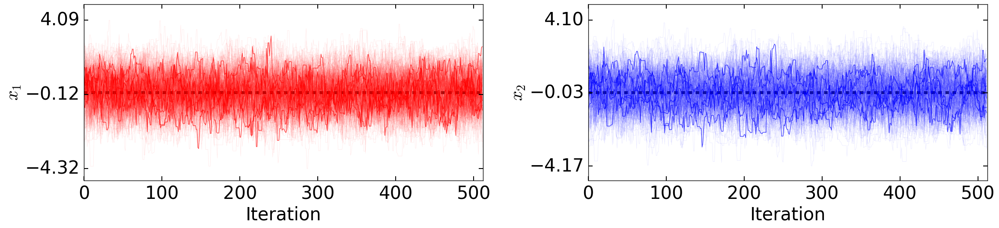

In [89]:
# plot trace
hwalkers = choice(Nwalkers, replace=False, size=5) # random selection of walkers to highlight to gauge behavior
figure(figsize=(24,6))
for i in xrange(2):
    subplot(1,2,i+1)
    samples = pos_chain_ehmc[:,:,i] # grab samples
    plot(arange(Niter), samples, lw=0.5, alpha=0.1, color=varcolors[i]) # all walkers
    plot(arange(Niter), samples[:,hwalkers], lw=1, alpha=0.7, color=varcolors[i]) # highlighted
    hlines(thetas_true[i], 0, Niter, colors='black', linestyles='dashed', lw=5, alpha=0.8, zorder=2)
    ymin, ymax = samples.min(), samples.max()
    yticks(linspace(ymin, ymax, 3).round(2))
    xlabel('Iteration')
    xlim([0, Niter])
    ylabel(varnames[i])
    tight_layout()

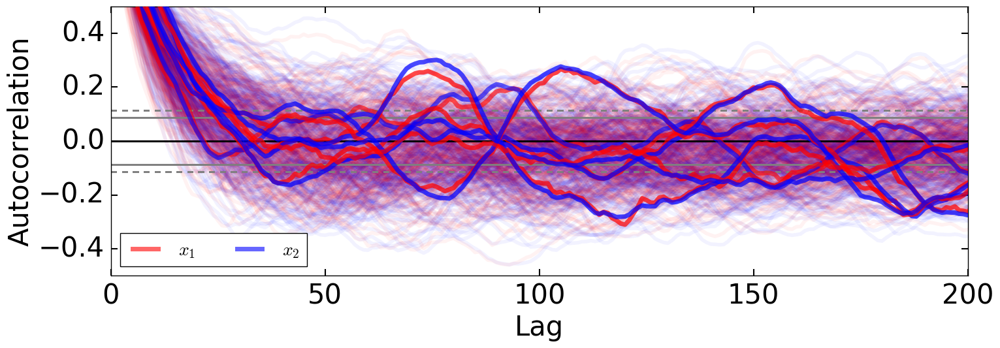

In [90]:
# plot autocorrelation lag
figure(figsize=(16,6))
h = [autocorrelation_plot(pos_chain_ehmc[:,hwalkers[0],i], color=varcolors[i], lw=5, alpha=0.6, zorder=10, label=varnames[i])
     for i in xrange(Ntheta)]
h = [[autocorrelation_plot(pos_chain_ehmc[:,j,i], color=varcolors[i], lw=5, alpha=0.7, zorder=10)
     for i in xrange(Ntheta)] 
    for j in hwalkers[1:]]
h = [[autocorrelation_plot(pos_chain_ehmc[:,j,i], color=varcolors[i], lw=4, alpha=0.05, zorder=1)
     for i in xrange(Ntheta)] 
    for j in xrange(Nwalkers)]
xlim([0, 200])
ylim([-0.5, 0.5])
legend(loc='best', fontsize=20, ncol=Ntheta)
tight_layout()

As expected, we appear to take a hit to our sampling efficiency.

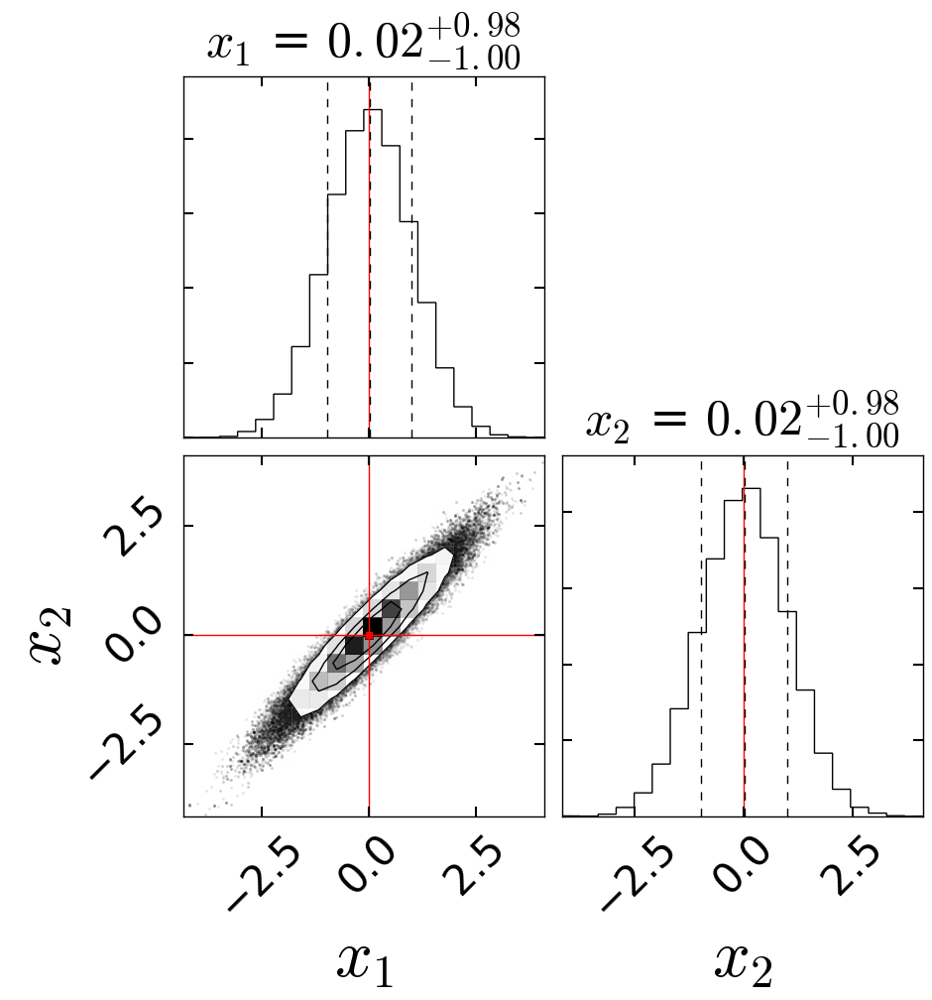

In [91]:
fig = corner.corner(pos_chain_ehmc.reshape(-1,Ntheta), quantiles=[.16, .50, .84],
                    labels=varnames, label_kwargs={'fontsize':48}, 
                    truths=thetas_true, truth_color='red', 
                    show_titles=True, title_kwargs={'y':1.04},
                    fig=subplots(2,2,figsize=(10,10))[0])

## Rosenbrock

Let's now attempt to sample from the Rosenbrock (i.e. the infamous "banana").

In [92]:
a, b = 1., 100.
thetas_true = array([1., 1.])
Ntheta = 2

def lnp_rbrock(x):
    x1, x2 = x
    return -1 * ( (a - x1)**2 + b * (x2 - x1**2)**2 )

def lnp_rbrock_grad(x):
    x1, x2 = x
    dx1 = 2 * ( (a - x1) + b * x1 * (x2 - x1**2) )
    dx2 = -2 * b * (x2 - x1**2)
    return array([dx1, dx2])
    
def lnp_rbrock_grad_cond(x1, x2):
    dx1 = 2 * ( (a - x1) + b * x1 * (x2 - x1**2) )
    return dx1

In [93]:
Nwalkers = 256 # number of walkers
pos_init = multivariate_normal(zeros(Ntheta), prop_cov, size=Nwalkers) # initial positions
lnp_init = array([lnp_rbrock(p) for p in pos_init]) # initial lnPs
Nburn, Niter = 512, 512 # number of burn-in and sampling iterations
T_max = 25. # starting (maximum) temperature

In [94]:
emcee_sampler = fit.emcee_sampler(Niter, pos_init, lnp_init, lnp_rbrock, Nburn, T_max, burn_schedule=25) # run emcee
pos_chain_emcee, lnp_chain_emcee, pos_burn_emcee, lnp_burn_emcee = emcee_sampler # re-assign outputs

10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 

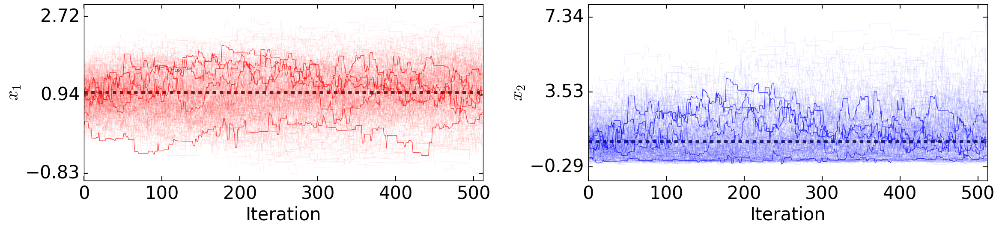

In [95]:
# plot trace
hwalkers = choice(Nwalkers, replace=False, size=5) # random selection of walkers to highlight to gauge behavior
figure(figsize=(24,6))
for i in xrange(2):
    subplot(1,2,i+1)
    samples = pos_chain_emcee[:,:,i] # grab samples
    plot(arange(Niter), samples, lw=0.5, alpha=0.1, color=varcolors[i]) # all walkers
    plot(arange(Niter), samples[:,hwalkers], lw=1, alpha=0.7, color=varcolors[i]) # highlighted
    hlines(thetas_true[i], 0, Niter, colors='black', linestyles='dashed', lw=5, alpha=0.8, zorder=2)
    ymin, ymax = samples.min(), samples.max()
    yticks(linspace(ymin, ymax, 3).round(2))
    xlabel('Iteration')
    xlim([0, Niter])
    ylabel(varnames[i])
    tight_layout()

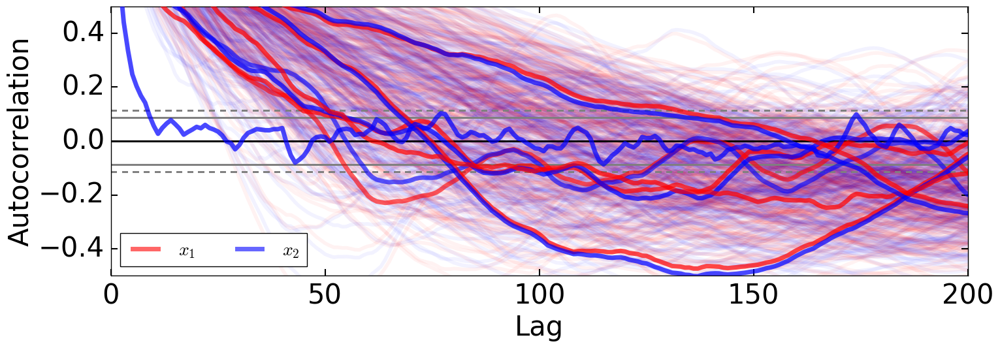

In [96]:
# plot autocorrelation lag
figure(figsize=(16,6))
h = [autocorrelation_plot(pos_chain_emcee[:,hwalkers[0],i], color=varcolors[i], lw=5, alpha=0.6, zorder=10, label=varnames[i])
     for i in xrange(Ntheta)]
h = [[autocorrelation_plot(pos_chain_emcee[:,j,i], color=varcolors[i], lw=5, alpha=0.7, zorder=10)
     for i in xrange(Ntheta)] 
    for j in hwalkers[1:]]
h = [[autocorrelation_plot(pos_chain_emcee[:,j,i], color=varcolors[i], lw=4, alpha=0.05, zorder=1)
     for i in xrange(Ntheta)] 
    for j in xrange(Nwalkers)]
xlim([0, 200])
ylim([-0.5, 0.5])
legend(loc='best', fontsize=20, ncol=Ntheta)
tight_layout()

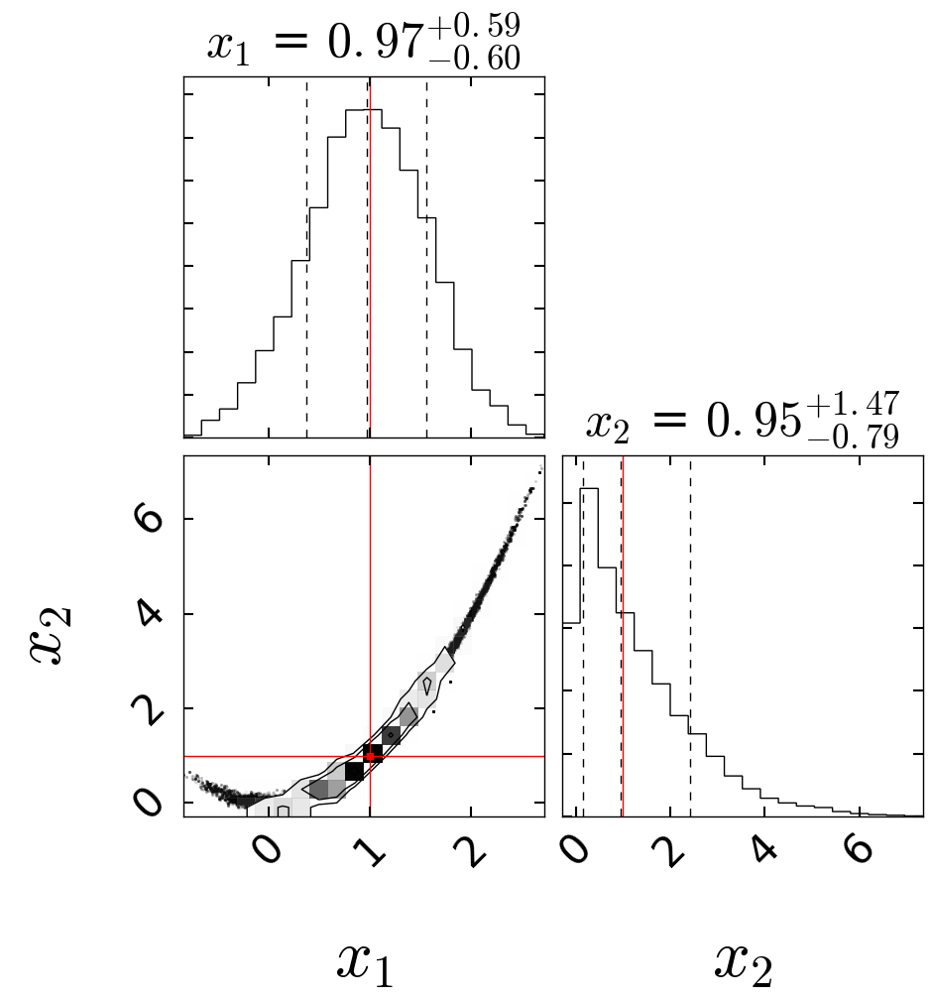

In [97]:
fig = corner.corner(pos_chain_emcee.reshape(-1,Ntheta), quantiles=[.16, .50, .84],
                    labels=varnames, label_kwargs={'fontsize':48}, 
                    truths=thetas_true, truth_color='red', 
                    show_titles=True, title_kwargs={'y':1.04},
                    fig=subplots(2,2,figsize=(10,10))[0])

In [105]:
L, epsilon = 50, 0.2
pos_init = array([1., 1.])
mass = eye(2) * b
mass_inv = inv(mass)
Niter = 10000

In [106]:
pos_chain_hmc, lnp_chain_hmc = fit.hmc_sampler(pos_init, Niter, L, epsilon, mass, mass_inv, lnp_rbrock, lnp_rbrock_grad)

0 100 200 300 400 500 600 700 800 900 1000 1100 1200 1300 1400 1500 1600 1700 1800 1900 2000 2100 2200 2300 2400 2500 2600 2700 2800 2900 3000 3100 3200 3300 3400 3500 3600 3700 3800 3900 4000 4100 4200 4300 4400 4500 4600 4700 4800 4900 5000 5100 5200 5300 5400 5500 5600 5700 5800 5900 6000 6100 6200 6300 6400 6500 6600 6700 6800 6900 7000 7100 7200 7300 7400 7500 7600 7700 7800 7900 8000 8100 8200 8300 8400 8500 8600 8700 8800 8900 9000 9100 9200 9300 9400 9500 9600 9700 9800 9900 

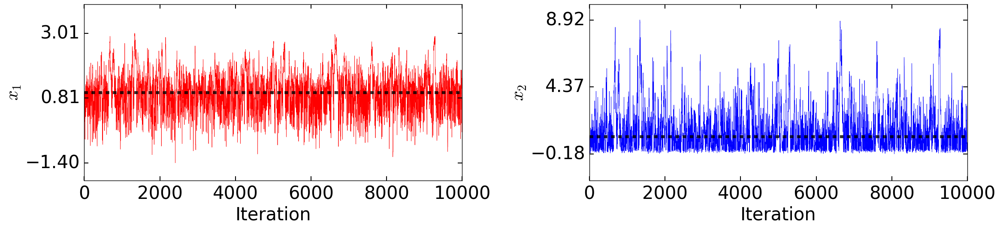

In [107]:
# plot trace
figure(figsize=(24,6))
for i in xrange(2):
    subplot(1,2,i+1)
    samples = pos_chain_hmc[:,i]
    plot(arange(Niter), samples, lw=0.5, color=varcolors[i], zorder=1)
    hlines(thetas_true[i], 0, Niter, colors='black', linestyles='dashed', lw=5, alpha=0.8, zorder=2)
    ymin, ymax = samples.min(), samples.max()
    yticks(linspace(ymin, ymax, 3).round(2))
    xlabel('Iteration')
    xlim([0, Niter])
    ylabel(varnames[i])
    tight_layout()

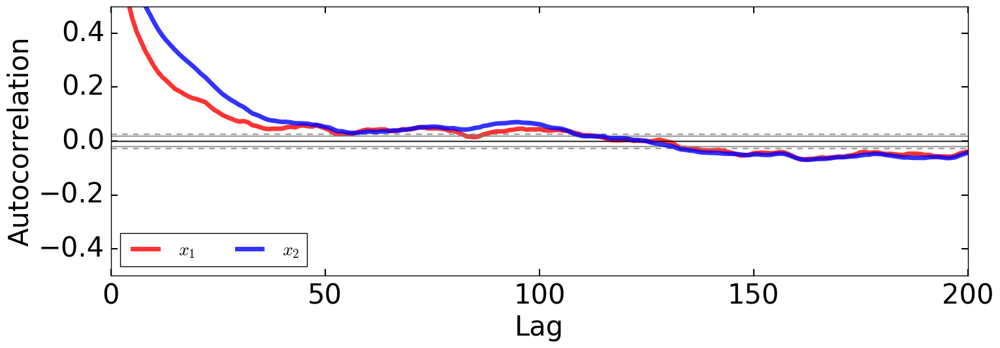

In [108]:
# plot autocorrelation lag
figure(figsize=(16,6))
h = [autocorrelation_plot(pos_chain_hmc[:,i], color=varcolors[i], lw=5, alpha=0.8, label=varnames[i])
     for i in xrange(Ntheta)]
xlim([0, 200])
ylim([-0.5,0.5])
legend(loc='best', fontsize=20, ncol=Ntheta)
tight_layout()

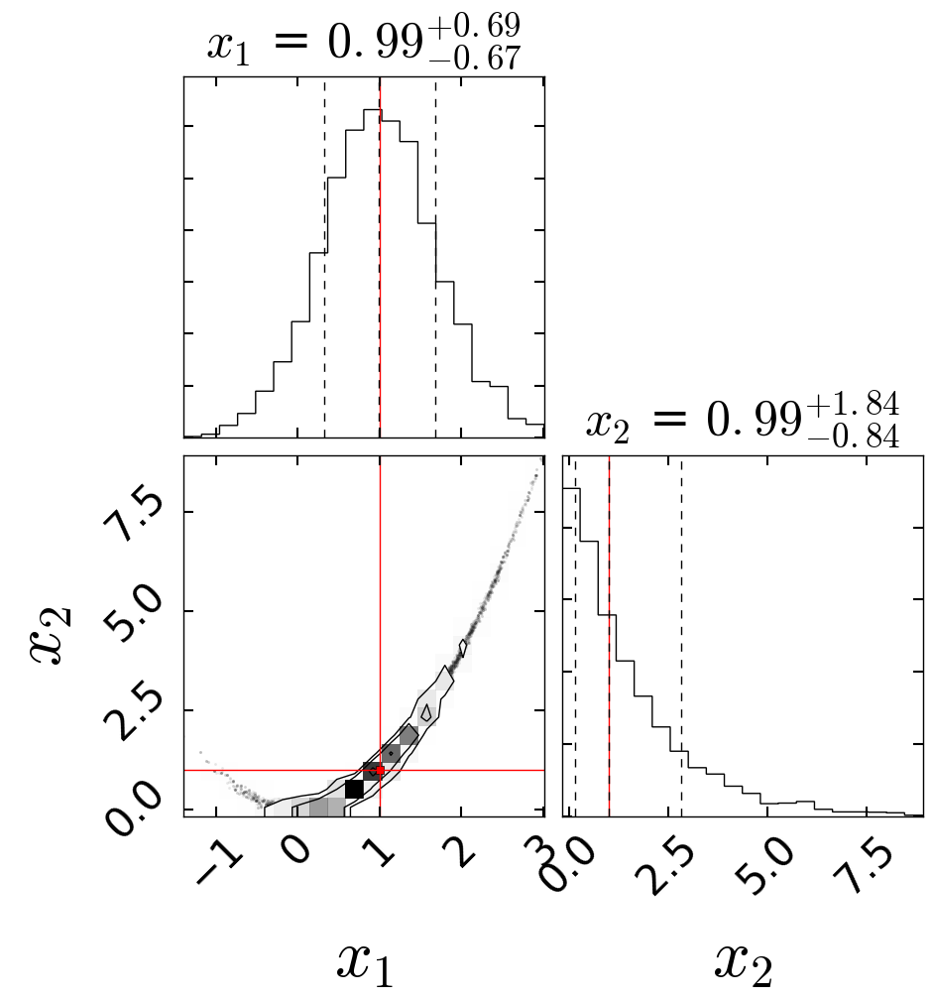

In [109]:
fig = corner.corner(pos_chain_hmc, quantiles=[.16, .50, .84],
                    labels=varnames, label_kwargs={'fontsize':48}, 
                    truths=thetas_true, truth_color='red', 
                    show_titles=True, title_kwargs={'y':1.04},
                    fig=subplots(2,2,figsize=(10,10))[0])

In [114]:
Nwalkers = 256 # number of walkers
pos_init = multivariate_normal(zeros(Ntheta), prop_cov, size=Nwalkers) # initial positions
lnp_init = array([lnp_rbrock(p) for p in pos_init]) # initial lnPs
Nburn, Niter = 512, 512 # number of burn-in and sampling iterations
T_max = 25. # starting (maximum) temperature
L, epsilon = 50, 0.2 # integration length and timesteps
gradsel = array([True, False]) # variables to sample with HMC
mass = array([[1.]]) * b * 4 # mass matrix
mass_inv = inv(mass) # inverse mass matrix

In [115]:
ehmc_sampler = fit.ehmc_sampler(Niter, pos_init, lnp_init, Nburn, T_max, L, epsilon, mass, mass_inv, 
                                lnp_rbrock, lnp_rbrock_grad_cond, gradsel, burn_schedule=25.)
pos_chain_ehmc, lnp_chain_ehmc, pos_burn_ehmc, lnp_burn_ehmc = ehmc_sampler # re-assign outputs

10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 

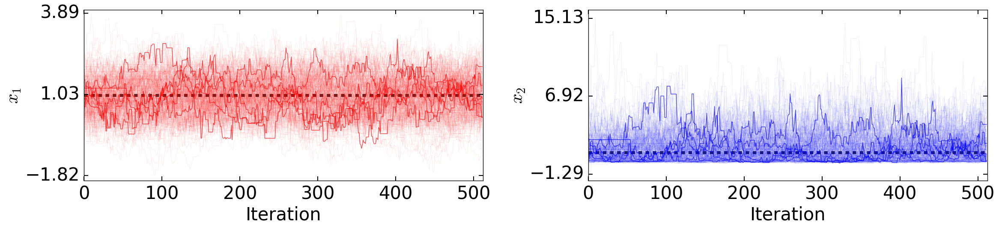

In [116]:
# plot trace
hwalkers = choice(Nwalkers, replace=False, size=5) # random selection of walkers to highlight to gauge behavior
figure(figsize=(24,6))
for i in xrange(2):
    subplot(1,2,i+1)
    samples = pos_chain_ehmc[:,:,i] # grab samples
    plot(arange(Niter), samples, lw=0.5, alpha=0.1, color=varcolors[i]) # all walkers
    plot(arange(Niter), samples[:,hwalkers], lw=1, alpha=0.7, color=varcolors[i]) # highlighted
    hlines(thetas_true[i], 0, Niter, colors='black', linestyles='dashed', lw=5, alpha=0.8, zorder=2)
    ymin, ymax = samples.min(), samples.max()
    yticks(linspace(ymin, ymax, 3).round(2))
    xlabel('Iteration')
    xlim([0, Niter])
    ylabel(varnames[i])
    tight_layout()

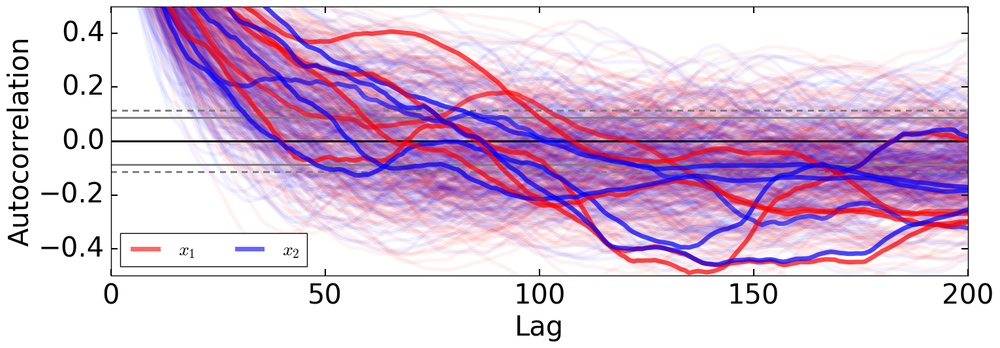

In [117]:
# plot autocorrelation lag
figure(figsize=(16,6))
h = [autocorrelation_plot(pos_chain_ehmc[:,hwalkers[0],i], color=varcolors[i], lw=5, alpha=0.6, zorder=10, label=varnames[i])
     for i in xrange(Ntheta)]
h = [[autocorrelation_plot(pos_chain_ehmc[:,j,i], color=varcolors[i], lw=5, alpha=0.7, zorder=10)
     for i in xrange(Ntheta)] 
    for j in hwalkers[1:]]
h = [[autocorrelation_plot(pos_chain_ehmc[:,j,i], color=varcolors[i], lw=4, alpha=0.05, zorder=1)
     for i in xrange(Ntheta)] 
    for j in xrange(Nwalkers)]
xlim([0, 200])
ylim([-0.5, 0.5])
legend(loc='best', fontsize=20, ncol=Ntheta)
tight_layout()

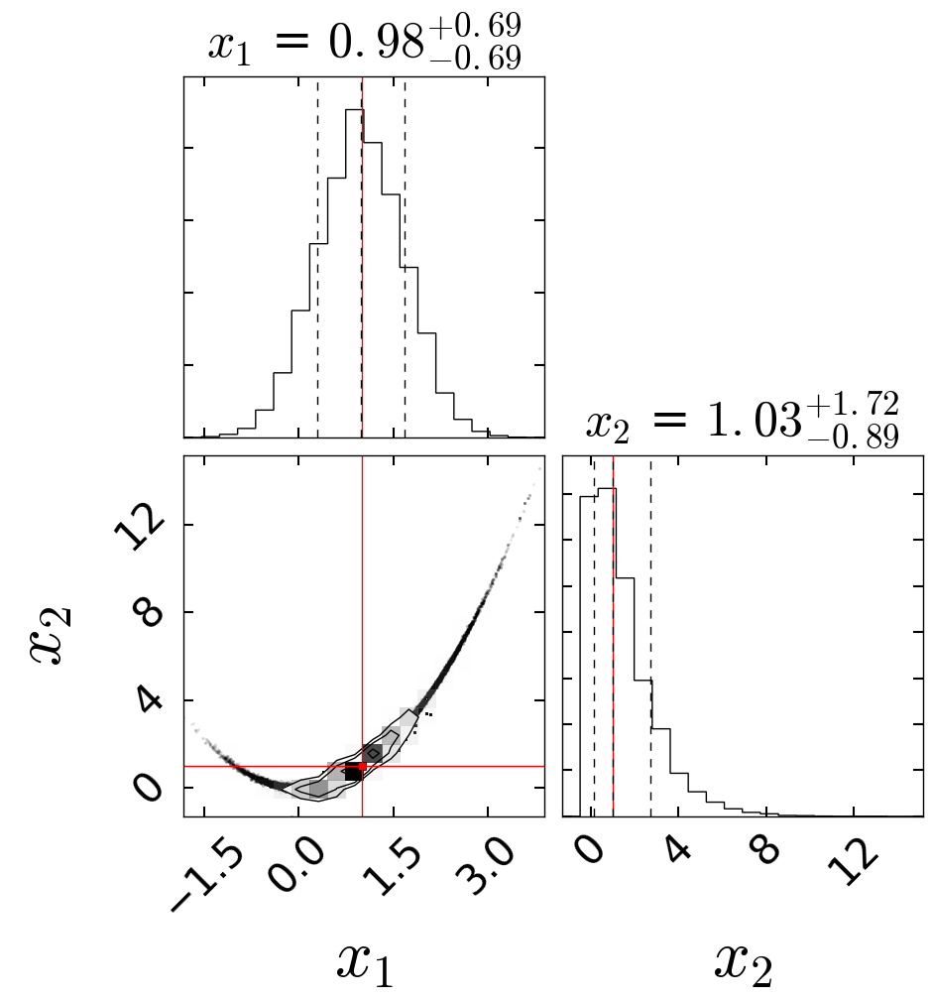

In [118]:
fig = corner.corner(pos_chain_ehmc.reshape(-1,Ntheta), quantiles=[.16, .50, .84],
                    labels=varnames, label_kwargs={'fontsize':48}, 
                    truths=thetas_true, truth_color='red', 
                    show_titles=True, title_kwargs={'y':1.04},
                    fig=subplots(2,2,figsize=(10,10))[0])

## 10-D Correlated Normal

In [119]:
C = eye(10)
C[C==0] = 0.95
Cinv = inv(C)
C11, C22, C12, C21 = C[:8,:8], C[8:,8:], C[:8,8:], C[8:,:8]
C22inv = inv(C22)
cond_cov = C11 - dot(C12, dot(C22inv, C21))
cond_cov_inv = inv(cond_cov)
Ntheta = 10
thetas_true = zeros(10)

In [120]:
def lnp_10norm(x):
    return -0.5*dot(x.T, dot(Cinv, x))

def lnp_10norm_grad(x):
    return -dot(Cinv, x)

def lnp_10norm_grad_cond(x1, x2): # gradient of lnP(x1|x2)
    cond_mu = dot(C12, dot(C22inv, x2)) # conditional mean
    return -dot(cond_cov_inv, x1 - cond_mu)

In [123]:
Nwalkers = 256 # number of walkers
pos_init = multivariate_normal(zeros(Ntheta), eye(10), size=Nwalkers) # initial positions
lnp_init = array([lnp_10norm(p) for p in pos_init]) # initial lnPs
Nburn, Niter = 128, 512 # number of burn-in and sampling iterations
T_max = 25. # starting (maximum) temperature

In [124]:
emcee_sampler = fit.emcee_sampler(Niter, pos_init, lnp_init, lnp_10norm, Nburn, T_max) # run emcee
pos_chain_emcee, lnp_chain_emcee, pos_burn_emcee, lnp_burn_emcee = emcee_sampler # re-assign outputs

10 20 30 40 50 60 70 80 90 100 110 120 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 

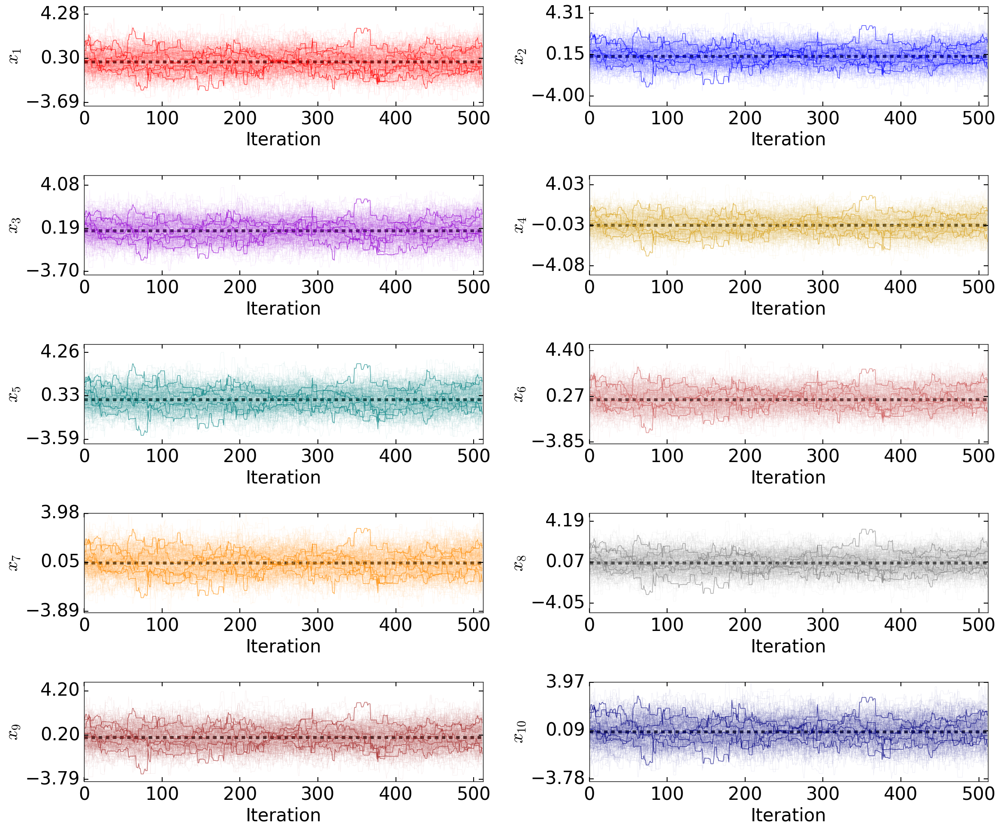

In [125]:
# plot trace
varcolors = ['red', 'blue', 'darkviolet', 'goldenrod', 'teal', 'indianred', 'darkorange', 'gray', 'brown', 'navy']
varnames = ['$x_{'+str(i+1)+'}$' for i in xrange(Ntheta)]
hwalkers = choice(Nwalkers, replace=False, size=5) # random selection of walkers to highlight to gauge behavior
figure(figsize=(24,20))
for i in xrange(Ntheta):
    subplot(5,2,i+1)
    samples = pos_chain_emcee[:,:,i] # grab samples
    plot(arange(Niter), samples, lw=0.5, alpha=0.1, color=varcolors[i]) # all walkers
    plot(arange(Niter), samples[:,hwalkers], lw=1, alpha=0.7, color=varcolors[i]) # highlighted
    hlines(thetas_true[i], 0, Niter, colors='black', linestyles='dashed', lw=5, alpha=0.8, zorder=2)
    ymin, ymax = samples.min(), samples.max()
    yticks(linspace(ymin, ymax, 3).round(2))
    xlabel('Iteration')
    xlim([0, Niter])
    ylabel(varnames[i])
    tight_layout()

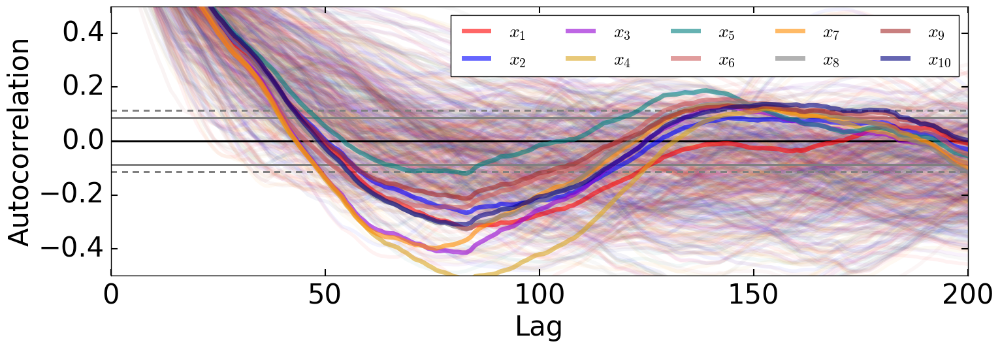

In [126]:
# plot autocorrelation lag
figure(figsize=(16,6))
h = [autocorrelation_plot(pos_chain_emcee[:,hwalkers[0],i], color=varcolors[i], lw=5, alpha=0.6, zorder=10, label=varnames[i])
     for i in xrange(Ntheta)]
h = [[autocorrelation_plot(pos_chain_emcee[:,j,i], color=varcolors[i], lw=4, alpha=0.05, zorder=1)
     for i in xrange(Ntheta)] 
    for j in choice(Nwalkers, size=50, replace=False)]
xlim([0, 200])
ylim([-0.5, 0.5])
legend(loc='best', fontsize=20, ncol=Ntheta/2)
tight_layout()

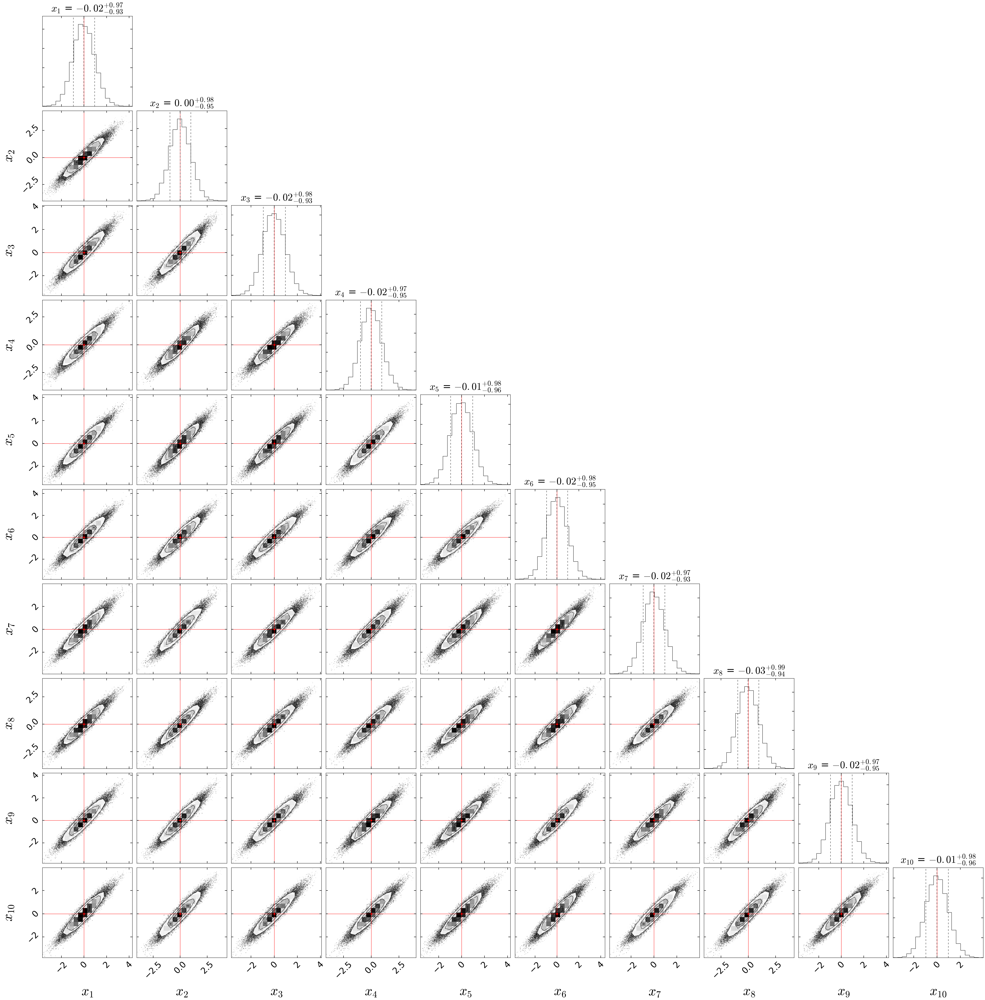

In [127]:
fig = corner.corner(pos_chain_emcee.reshape(-1,Ntheta), quantiles=[.16, .50, .84],
                    labels=varnames, label_kwargs={'fontsize':48}, 
                    truths=thetas_true, truth_color='red', 
                    show_titles=True, title_kwargs={'y':1.04},
                    fig=subplots(10,10,figsize=(50,50))[0])

In [128]:
L, epsilon = 50, 0.1
pos_init = zeros(10)
mass = eye(10)
mass_inv = inv(mass)
Niter = 10000

In [129]:
pos_chain_hmc, lnp_chain_hmc = fit.hmc_sampler(pos_init, Niter, L, epsilon, mass, mass_inv, lnp_10norm, lnp_10norm_grad)

0 100 200 300 400 500 600 700 800 900 1000 1100 1200 1300 1400 1500 1600 1700 1800 1900 2000 2100 2200 2300 2400 2500 2600 2700 2800 2900 3000 3100 3200 3300 3400 3500 3600 3700 3800 3900 4000 4100 4200 4300 4400 4500 4600 4700 4800 4900 5000 5100 5200 5300 5400 5500 5600 5700 5800 5900 6000 6100 6200 6300 6400 6500 6600 6700 6800 6900 7000 7100 7200 7300 7400 7500 7600 7700 7800 7900 8000 8100 8200 8300 8400 8500 8600 8700 8800 8900 9000 9100 9200 9300 9400 9500 9600 9700 9800 9900 

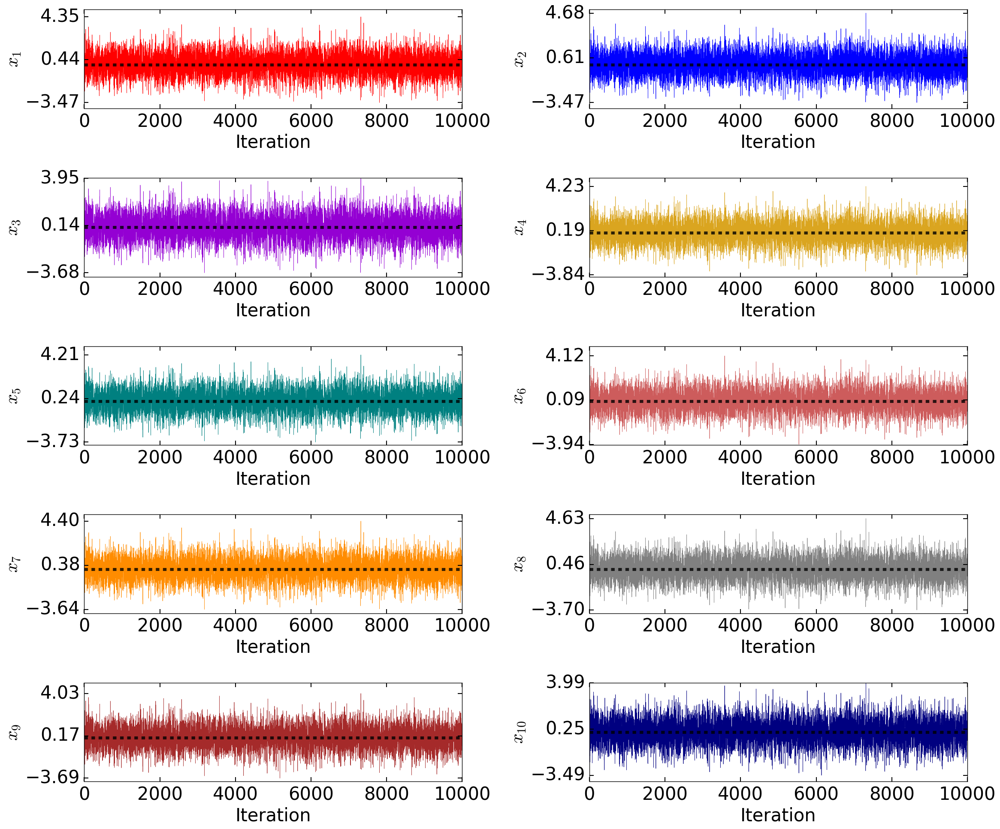

In [130]:
# plot trace
figure(figsize=(24,20))
for i in xrange(Ntheta):
    subplot(5,2,i+1)
    samples = pos_chain_hmc[:,i]
    plot(arange(Niter), samples, lw=0.5, color=varcolors[i], zorder=1)
    hlines(thetas_true[i], 0, Niter, colors='black', linestyles='dashed', lw=5, alpha=0.8, zorder=2)
    ymin, ymax = samples.min(), samples.max()
    yticks(linspace(ymin, ymax, 3).round(2))
    xlabel('Iteration')
    xlim([0, Niter])
    ylabel(varnames[i])
    tight_layout()

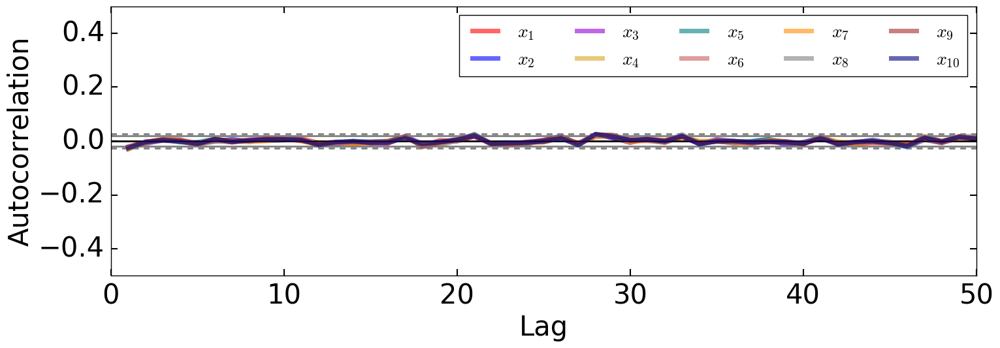

In [131]:
# plot autocorrelation lag
figure(figsize=(16,6))
h = [autocorrelation_plot(pos_chain_hmc[:,i], color=varcolors[i], lw=5, alpha=0.6, label=varnames[i])
     for i in xrange(Ntheta)]
xlim([0, 50])
ylim([-0.5,0.5])
legend(loc='best', fontsize=20, ncol=Ntheta/2)
tight_layout()

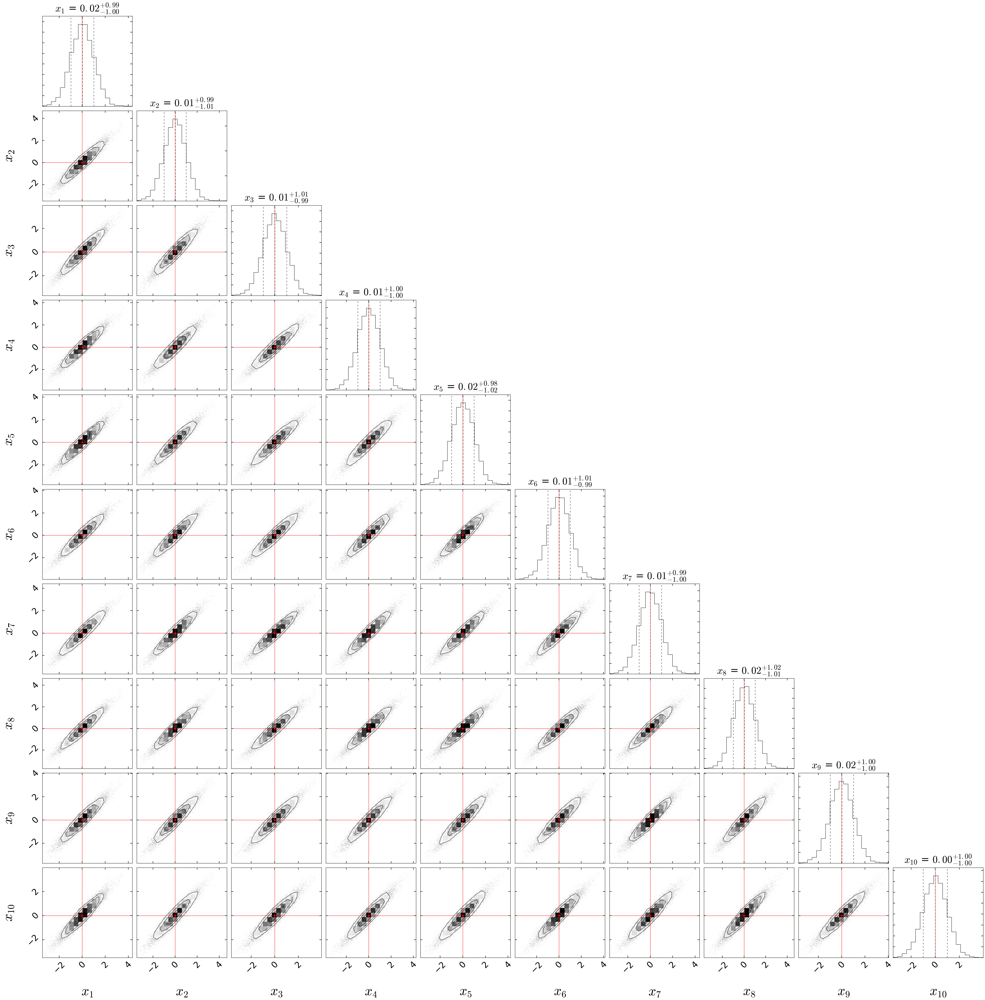

In [132]:
fig = corner.corner(pos_chain_hmc, quantiles=[.16, .50, .84],
                    labels=varnames, label_kwargs={'fontsize':48}, 
                    truths=thetas_true, truth_color='red', 
                    show_titles=True, title_kwargs={'y':1.04},
                    fig=subplots(10,10,figsize=(50,50))[0])

In [133]:
Nwalkers = 256 # number of walkers
pos_init = multivariate_normal(zeros(Ntheta), eye(10), size=Nwalkers) # initial positions
lnp_init = array([lnp_10norm(p) for p in pos_init]) # initial lnPs
Nburn, Niter = 128, 512 # number of burn-in and sampling iterations
T_max = 25. # starting (maximum) temperature
L, epsilon = 50, 0.1 # integration length and timesteps
gradsel = ones(10, dtype='bool') # variables to sample with HMC
gradsel[8:] = False
mass = eye(8) # mass matrix
mass_inv = inv(mass) # inverse mass matrix

In [134]:
ehmc_sampler = fit.ehmc_sampler(Niter, pos_init, lnp_init, Nburn, T_max, L, epsilon, mass, mass_inv, 
                                lnp_10norm, lnp_10norm_grad_cond, gradsel)
pos_chain_ehmc, lnp_chain_ehmc, pos_burn_ehmc, lnp_burn_ehmc = ehmc_sampler # re-assign outputs

10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 

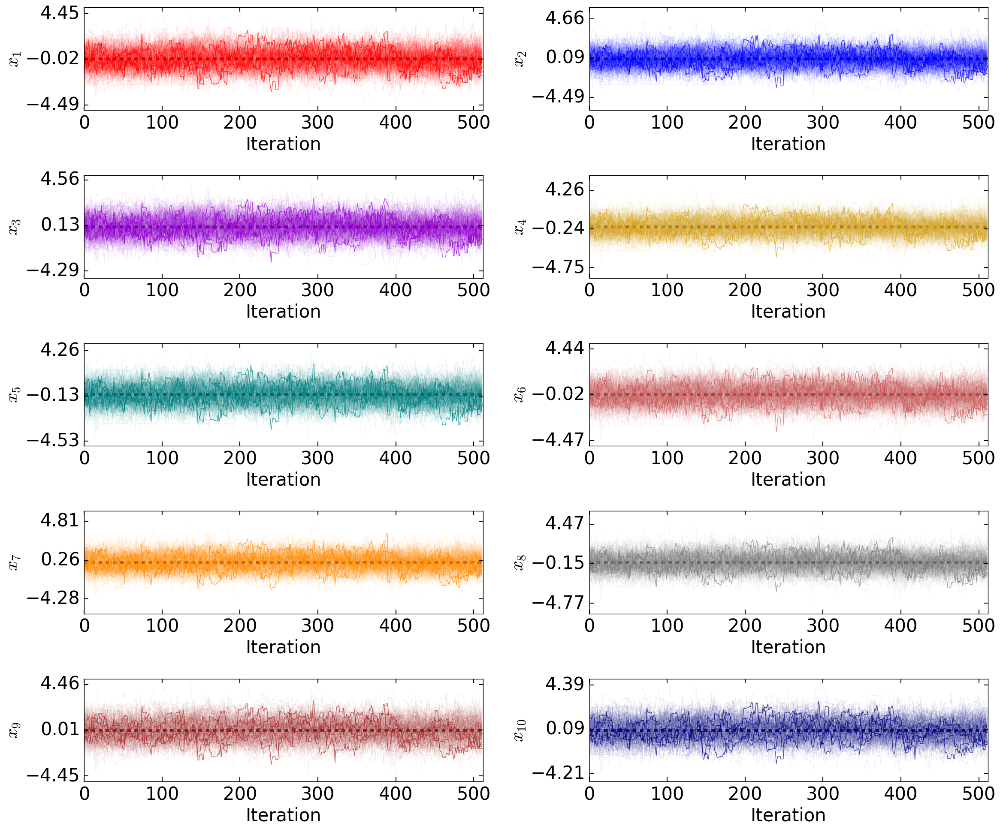

In [135]:
figure(figsize=(24,20))
for i in xrange(Ntheta):
    subplot(5,2,i+1)
    samples = pos_chain_ehmc[:,:,i] # grab samples
    plot(arange(Niter), samples, lw=0.5, alpha=0.1, color=varcolors[i]) # all walkers
    plot(arange(Niter), samples[:,hwalkers], lw=1, alpha=0.7, color=varcolors[i]) # highlighted
    hlines(thetas_true[i], 0, Niter, colors='black', linestyles='dashed', lw=5, alpha=0.8, zorder=2)
    ymin, ymax = samples.min(), samples.max()
    yticks(linspace(ymin, ymax, 3).round(2))
    xlabel('Iteration')
    xlim([0, Niter])
    ylabel(varnames[i])
    tight_layout()

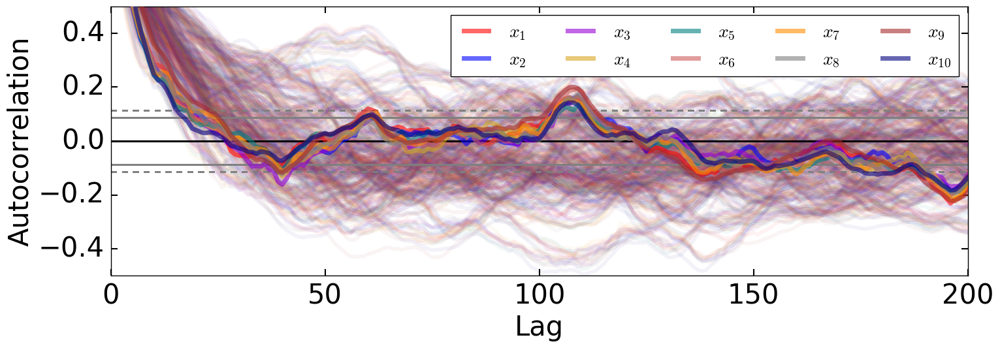

In [136]:
# plot autocorrelation lag
figure(figsize=(16,6))
h = [autocorrelation_plot(pos_chain_ehmc[:,hwalkers[0],i], color=varcolors[i], lw=5, alpha=0.6, zorder=10, label=varnames[i])
     for i in xrange(Ntheta)]
h = [[autocorrelation_plot(pos_chain_ehmc[:,j,i], color=varcolors[i], lw=4, alpha=0.05, zorder=1)
     for i in xrange(Ntheta)] 
    for j in choice(Nwalkers, size=50, replace=False)]
xlim([0, 200])
ylim([-0.5, 0.5])
legend(loc='best', fontsize=20, ncol=Ntheta/2)
tight_layout()

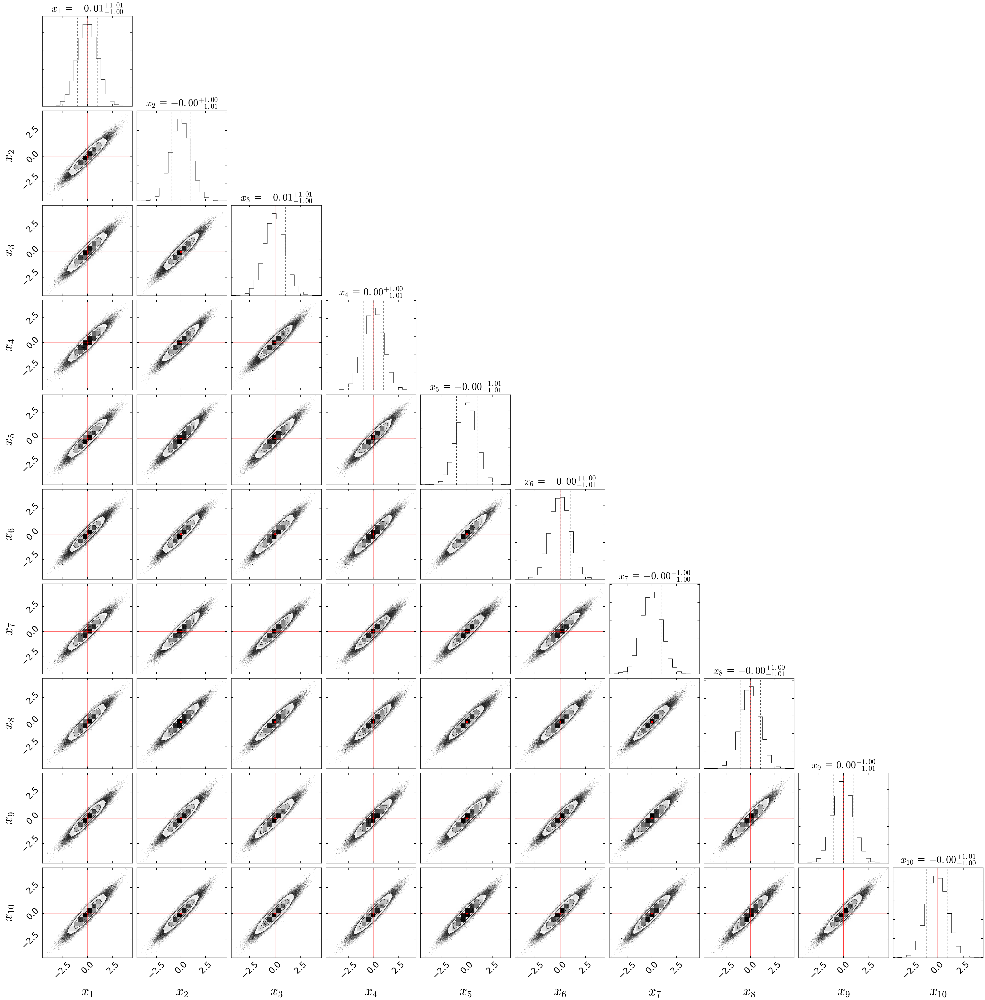

In [137]:
fig = corner.corner(pos_chain_ehmc.reshape(-1,Ntheta), quantiles=[.16, .50, .84],
                    labels=varnames, label_kwargs={'fontsize':48}, 
                    truths=thetas_true, truth_color='red', 
                    show_titles=True, title_kwargs={'y':1.04},
                    fig=subplots(10,10,figsize=(50,50))[0])